# Segmenting and Clustering Major Cities in Germany
by Uygar Hizal

<div class="alert alert-success" role="alert">
<h2 class="alert-heading">Table of Contents </h2>
    
     
  <h3> <a href="#item0" class="alert-link">  ●  Installing and importing necessary modules and libraries</a><br>  </h3> 
  <h3> <a href="#item1" class="alert-link">  1. Wikipedia Scraper with Results stored into a data frame </a><br> </h3>
  <h3> <a href="#item2" class="alert-link">  2. Adding Latitude and Longitude values to our data frame </a><br>  </h3>
    <h3> <a href="#item3" class="alert-link">  3. Adding Avg. Income/Person Column to our data frame </a><br>  </h3> 
     <h3> <a href="#item4" class="alert-link">  4. Adding Avg. Unemployment Rates to our data frame  </a><br>  </h3>
    <h3> <a href="#item5" class="alert-link">  5. Putting all columns together and see the final Data Frame of Cities (dfinal) </a><br>  </h3>
    <h3> <a href="#item6" class="alert-link">  6. Creating A Folium map for (Initial) Visualising of Concerned Cities </a><br>  </h3>
    
<h3> <a href="#item7" class="alert-link">  7. Power of Venues (tagesorten) </a><br>  </h3>
   
  <ul> 
   <li><h4> <a href="#item7A" class="alert-link"> 7.A) Geo coordinates </a> <br>  </h4> </li>    
   <li><h4> <a href="#item7B" class="alert-link"> 7.B) Getting venues for all Major Cities in Germany (with a Function) </a><br>   </h4> </li>    
   <li><h4> <a href="#item7C" class="alert-link"> 7.C) Analyze Each City</a> <br>   </h4>  </li>   
   <li><h4> <a href="#item7D" class="alert-link"> 7.D) Cluster Cities</a> <br>   </h4>  </li>   
   <li><h4> <a href="#item7E" class="alert-link"> 7.E) Examine Clusters</a> <br> </h4> </li> 
    </ul>    
  
        
</div>




<a id='item0'></a>

## Installing and importing necessary modules and libraries

In [4]:
!pip install geopy 
!pip install folium
!pip install geoplot  # ? if necessary
!pip install geopandas
!pip install descartes
!pip install xlrd
!pip install lxml
!pip install seaborn

     |████████████████████████████████| 102kB 8.1MB/s ta 0:00:011
     |████████████████████████████████| 8.9MB 14.2MB/s eta 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 921kB 30.2MB/s eta 0:00:01
     |████████████████████████████████| 1.5MB 36.8MB/s eta 0:00:01
     |████████████████████████████████| 11.8MB 11.8MB/s eta 0:00:01    |████████                        | 2.9MB 11.8MB/s eta 0:00:01     |█████████████████████▏          | 7.8MB 11.8MB/s eta 0:00:01
     |████████████████████████████████| 296kB 34.9MB/s eta 0:00:01
     |████████████████████████████████| 15.2MB 33.8MB/s eta 0:00:01    |███▉                            | 1.8MB 33.8MB/s eta 0:00:01     |██████                          | 2.8MB 33.8MB/s eta 0:00:01     |████████▏                       | 3.9MB 33.8MB/s eta 0:00:01     |███████████████████████▍        | 11.1MB 33.8MB/s eta 0:00:01
     |███

#### importing necessary libraries to our enviorenment  ------>

In [5]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis

import seaborn as sns 

import xlrd

import requests # library to handle requests

import json # library to handle JSON files

import folium # map rendering library

import geopandas
import descartes

import geoplot  # ? if necessary



from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe



# Matplotlib and associated plotting modules
%matplotlib inline
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
from matplotlib import style 

#import k-means from clustering stage
from sklearn.cluster import KMeans


from geopy.geocoders import Nominatim # convert an address into latitude and longitude values


print('Libraries imported.')

Libraries imported.


Setting Up some library parameters ------>

In [6]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [7]:

%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 12]
plt.rcParams['figure.dpi'] = 200

<a id='item1'></a>

## 1. Wikipedia Scraper with Results stored into a data frame

In [8]:

url1 = 'https://de.wikipedia.org/wiki/Liste_der_Gro%C3%9Fst%C3%A4dte_in_Deutschland'

url2 = 'https://de.wikipedia.org/wiki/Liste_der_Landkreise_nach_Einkommen'

url3 = 'https://www.dropbox.com/s/d6potozkgbtl3my/unemployment%20rate_cities.csv?dl=1'



In [9]:
df1 = pd.read_html(url1,header = 1,thousands='.')[0]  
df1 = df1[['Name', '2018', 'Ew./km²(2018)']]
df1 = df1.rename(columns = {'Name':'City', '2018':'Population 2018', 
                              'Ew./km²(2018)':'Population/km²'})
 


In [10]:

df1['City'] = df1.City.str.replace('\d+','')
df1.drop(df1.tail(2).index,inplace=True)

In [11]:
df1["City"].replace([',[\D]*$'], [''], regex=True, inplace=True)

In [12]:
df1["City"]=df1["City"].str.replace('­','')

In [13]:
df1[['Population 2018','Population/km²']] = df1[['Population 2018','Population/km²']].apply(pd.to_numeric)

In [14]:
df1['Area(km²)'] = df1['Population 2018'] // df1['Population/km²']

In [15]:
df1


,City,Population 2018,Population/km²,Area(km²)
0,Berlin,3644826,4088,891
1,Hamburg,1841179,2438,755
2,München,1471508,4736,310
3,Köln,1085664,2681,404
4,Frankfurt am Main,753056,3033,248
5,Stuttgart,634830,3062,207
6,Düsseldorf,619294,2849,217
7,Leipzig,587857,1974,297
8,Dortmund,587010,2091,280
9,Essen,583109,2772,210


<a id='item2'></a>

## 2. Adding Latitude and Longitude values to our data frame :

####  Now we will request and then add the coordinates of the cities to our dataframe (df1)

In [16]:
geolocator = Nominatim(user_agent="DE_explorerv3")

# iterate geocode to get and add coordinates of all cities
City_Lat = []
City_Long = []
for address in df1['City']:
    
    location = geolocator.geocode(address)
    if location:
        c_latitude = location.latitude
        c_longitude = location.longitude
        City_Lat.append(c_latitude)
        City_Long.append(c_longitude)

Lets see if all cities are parsed to new dataframes (we had 81 Cities) :

In [17]:
print(len(City_Lat),len(City_Long))

81 81


Now Being sure that NR. of rows in City_lat and City_long  is equal to NR. Cities in df1 , we can add 2 columns safely ;

In [18]:
df1['City_Lat']= City_Lat
df1['City_Long']= City_Long

Checking data types are very important because often numerial columns can be rendered as string causing calculation errors later.. :

In [19]:
df1.dtypes

City                object
Population 2018      int64
Population/km²       int64
Area(km²)            int64
City_Lat           float64
City_Long          float64
dtype: object

In [20]:
df1.head(10)

,City,Population 2018,Population/km²,Area(km²),City_Lat,City_Long
0,Berlin,3644826,4088,891,52.517037,13.388860
1,Hamburg,1841179,2438,755,53.550341,10.000654
2,München,1471508,4736,310,48.137108,11.575382
3,Köln,1085664,2681,404,50.938361,6.959974
4,Frankfurt am Main,753056,3033,248,50.110644,8.682092
5,Stuttgart,634830,3062,207,48.778449,9.180013
6,Düsseldorf,619294,2849,217,51.225402,6.776314
7,Leipzig,587857,1974,297,51.340632,12.374733
8,Dortmund,587010,2091,280,51.514227,7.465279
9,Essen,583109,2772,210,51.457087,7.011429


<a id='item3'></a>

## 3. Adding Avg. Income/Person Column to our data frame :

Following steps includes : scraping ,creating, cleaning , Income Data (frame) for each cities (not only big cities but all German cities) :

In [21]:
df2 = pd.read_html(url2,thousands='.')[0]
df2 = df2[['Landkreis/Kreis/(Stadt)','Einkommen pro Kopfin Euro']].copy()

In [22]:
df2.rename(columns = {'Landkreis/Kreis/(Stadt)':'City','Einkommen pro Kopfin Euro':'Income /Pers. €'}, inplace = True) 

In [23]:
df2["City"].replace([',[\D]*$'], [''], regex=True, inplace=True)

In [24]:
df2 = df2.groupby('City').mean().reset_index()

In [25]:
df2.shape

(379, 2)

In [26]:
df2.head(10)

,City,Income /Pers. €
0,Aachen,19781.0
1,Ahrweiler,22962.0
2,Aichach-Friedberg,24748.0
3,Alb-Donau-Kreis,22884.0
4,Altenburger Land,18822.0
5,Altenkirchen (Westerwald),21176.0
6,Altmarkkreis Salzwedel,19255.0
7,Altötting,22865.0
8,Alzey-Worms,22245.0
9,Amberg,21583.0


<a id='item4'></a>

## 4. Adding Avg. Unemployment Rates to our data frame :

Following steps include : scraping ,creating, cleaning , Unemployment Data (frame) for each cities (not only big cities but all German cities) :

In [27]:
df3 = pd.read_csv(url3,sep=';',decimal=",",encoding='latin-1', na_values = ['-', '.'])

In [28]:
df3["City"].replace([',[\D]*$'], [''], regex=True, inplace=True)

In [29]:
df3['City'] = df3['City'].str.strip()

Below cell we are taking the avarage of male and female unemployment Columns :

In [30]:
df3['Average Unemployment rate'] = df3.mean(numeric_only=True, axis=1)

In [31]:
df3.dropna(inplace=True)

In [32]:
df3.drop(columns=['Unemployment rate Males','Unemployment rate Females'], inplace=True)

In [33]:
df3 = df3.groupby('City').mean().reset_index()

In [34]:
df3.shape

(393, 2)

In [35]:
df3.head(10)

,City,Average Unemployment rate
0,Ahrweiler,3.55
1,Aichach-Friedberg,2.05
2,Alb-Donau-Kreis,2.25
3,Altenburger Land,7.70
4,Altenkirchen (Westerwald),4.35
5,Altmarkkreis Salzwedel,7.00
6,Altötting,2.90
7,Alzey-Worms,3.70
8,Amberg,4.40
9,Amberg-Sulzbach,2.45


<a id='item5'></a>

 ## 5. Putting all columns together and see the final Data Frame of Cities (dfinal) :

#### Here we will add above created 2 extra valuable columns (Income/person  and avg. Unemployment rate) <br> <br> into our Main Data Frame df1


In [36]:
df1.head(10)

,City,Population 2018,Population/km²,Area(km²),City_Lat,City_Long
0,Berlin,3644826,4088,891,52.517037,13.388860
1,Hamburg,1841179,2438,755,53.550341,10.000654
2,München,1471508,4736,310,48.137108,11.575382
3,Köln,1085664,2681,404,50.938361,6.959974
4,Frankfurt am Main,753056,3033,248,50.110644,8.682092
5,Stuttgart,634830,3062,207,48.778449,9.180013
6,Düsseldorf,619294,2849,217,51.225402,6.776314
7,Leipzig,587857,1974,297,51.340632,12.374733
8,Dortmund,587010,2091,280,51.514227,7.465279
9,Essen,583109,2772,210,51.457087,7.011429


In [37]:
dfinal=df1.merge(df2, on="City")

In [38]:
dfinal=dfinal.merge(df3, on="City")

#### Now we are ended up with a nicely shaped and cleaned data frame with all desired columns in it..Lets see it: 

In [39]:
dfinal

,City,Population 2018,Population/km²,Area(km²),City_Lat,City_Long,Income /Pers. €,Average Unemployment rate
0,Berlin,3644826,4088,891,52.517037,13.388860,19719.0,8.100
1,Hamburg,1841179,2438,755,53.550341,10.000654,24421.0,6.300
2,München,1471508,4736,310,48.137108,11.575382,29788.0,3.100
3,Köln,1085664,2681,404,50.938361,6.959974,21608.0,7.850
4,Frankfurt am Main,753056,3033,248,50.110644,8.682092,21690.0,5.350
5,Stuttgart,634830,3062,207,48.778449,9.180013,25012.0,4.200
6,Düsseldorf,619294,2849,217,51.225402,6.776314,24882.0,6.700
7,Leipzig,587857,1974,297,51.340632,12.374733,19104.0,6.075
8,Dortmund,587010,2091,280,51.514227,7.465279,18946.0,10.200
9,Essen,583109,2772,210,51.457087,7.011429,20159.0,10.600


In [40]:
# Again after checking data types , we see that each numeric column is either integer or float (as desired)..

dfinal.dtypes

City                          object
Population 2018                int64
Population/km²                 int64
Area(km²)                      int64
City_Lat                     float64
City_Long                    float64
Income /Pers. €              float64
Average Unemployment rate    float64
dtype: object

<a id='item6'></a>

##  6. Creating A Folium map for (Initial) Visualising of Concerned Cities :

In [41]:
# Lets create the map of Germany using latitude and longitude values for ALL 81 Major Cities ! 
map_Germany_Cities = folium.Map(location=[52.517037, 13.388860], zoom_start=6)

# add markers to map
for lat, lng, city in zip(dfinal['City_Lat'], dfinal['City_Long'], dfinal['City']):
    label = '{}'.format(city)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_Germany_Cities)  
    
map_Germany_Cities

<a id='item7'></a>

## 7. Power of Venues (tagesorten) :

### --------FOURSQUARE ------------------------

In [42]:
CLIENT_ID = '███████████████████' # your Foursquare ID    (censored please put your credentials here)
CLIENT_SECRET = '█████████████████' # your Foursquare Secret  (censored)
VERSION = '20140517' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: ███████████████████
CLIENT_SECRET:█████████████████


### ----FUNCTION TO GET ALL CITIES' VENUES --------

In [43]:
LIMIT = 300

def getNearbyVenues(names, latitudes, longitudes, radius=1250):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['City', 
                  'City Latitude', 
                  'City Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

#### ----- Let's call the function (for 81 big cities in Germany) :

In [ ]:
Germany_venues = getNearbyVenues(names=df1['City'],
                                   latitudes=df1['City_Lat'],
                                   longitudes=df1['City_Long']
                                  )

In [ ]:
# It is a huge data frame with 5822 rows (=different venues)  in it
Germany_venues.shape

In [ ]:
Germany_venues.head(300)

#### Now we will save all these venue results into a csv file .This will allow us to NOT the call foursquere api each time , (consuming our API daily limit , and waiting too long for the run.We made it once and saved the results , no need to rerun each time.!)

In [ ]:
Germany_venues.to_csv("Germany_venues.csv")

### ---------------- FourSquare --------------------- Finish

As said above : we have already called the foursquere api , and saved all the results into the file named Germany_venues.csv ,<br>
Now it is time to work with these venue data..We will first load it to a pandas data frame with some cleaning :

In [44]:
Germany_venues = pd.read_csv("Germany_venues.csv", index_col='City') 
Germany_venues.drop(['City Latitude','City Longitude','Unnamed: 0'], axis=1, inplace=True)

In [45]:
Germany_venues.head(20)

,Venue,Venue Latitude,Venue Longitude,Venue Category
City,,,,
Berlin,Dussmann English Bookshop,52.518223,13.389239,Bookstore
Berlin,Dussmann das KulturKaufhaus,52.518398,13.388788,Bookstore
Berlin,Cookies Cream,52.516569,13.388008,Vegetarian / Vegan Restaurant
Berlin,Windhorst,52.518553,13.386270,Cocktail Bar
Berlin,Komische Oper,52.515968,13.386701,Opera House
Berlin,COS,52.515698,13.389298,Clothing Store
Berlin,Regent Berlin,52.515375,13.390937,Hotel
Berlin,Freundschaft,52.518294,13.390344,Wine Bar
Berlin,Lafayette Gourmet,52.514385,13.389569,Gourmet Shop


#### Let's check how many venues were returned for each City

In [46]:
Germany_venues[['Venue Category','Venue']].groupby('City').count().head(10)

,Venue Category,Venue
City,,
Aachen,100,100
Augsburg,100,100
Bergisch Gladbach,34,34
Berlin,100,100
Bielefeld,64,64
Bochum,100,100
Bonn,100,100
Bottrop,23,23
Braunschweig,100,100


The result above tells us a limititation of the foursquere (free) api , we are getting maximum 100 venues even for the biggest cities <br>
But still not bad for an education project..

#### Let's find out how many unique categories can be curated from all the returned venues

In [47]:
print('There are {} uniques categories.'.format(len(Germany_venues['Venue Category'].unique())))

There are 319 uniques categories.


## 3.C) Analyzing Each City (in our final data frame)

In [48]:
# one hot encoding
Germany_onehot = pd.get_dummies(Germany_venues[['Venue Category']], prefix="", prefix_sep="")



In [49]:
Germany_onehot.head()

,Accessories Store,Afghan Restaurant,African Restaurant,American Restaurant,Amphitheater,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Dealership,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Basketball Stadium,Bavarian Restaurant,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Belgian Restaurant,Big Box Store,Bike Shop,Bistro,Board Shop,Boarding House,Boat or Ferry,Bookstore,Botanical Garden,Boutique,Bowling Alley,Bratwurst Joint,Breakfast Spot,Brewery,Bridge,Building,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Butcher,Cable Car,Café,Camera Store,Candy Store,Capitol Building,Carpet Store,Casino,Castle,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Cigkofte Place,City Hall,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Auditorium,College Cafeteria,Comedy Club,Comfort Food Restaurant,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Credit Union,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Currywurst Joint,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Dive Bar,Doner Restaurant,Donut Shop,Drugstore,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Factory,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Field,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Fountain,Franconian Restaurant,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grilled Meat Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Halal Restaurant,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hockey Arena,Hockey Rink,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Hungarian Restaurant,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Insurance Office,Intersection,Irish Pub,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Laser Tag,Latin American Restaurant,Lawyer,Lebanese Restaurant,Light Rail Station,Liquor Store,Lottery Retailer,Lounge,Manti Place,Market,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Monastery,Mongolian Restaurant,Monument / Landmark,Moroccan Restaurant,Mountain,Movie Theater,Multiplex,Museum,Music Venue,Neighborhood,Nightclub,Noodle House,Opera House,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Outdoor Supply Store,Outlet Mall,Outlet Store,Palace,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Store,Pharmacy,Piano Bar,Pide Place,Pier,Pizza Place,Planetarium,Platform,Playground,Plaza,Polish Restaurant,Pool,Pool Hall,Portuguese Restaurant,Print Shop,Pub,Public Art,Racetrack,Ramen Restaurant,Record Shop,Rental Car Location,Residential Building (Apartment / Condo),Restaurant,Rhenisch Restaurant,River,Road,Rock Club,Roof Deck,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,Schnitzel Restaurant,Science Museum,Sculpture Garden,Seafood Restaurant,Shipping Store,Shoe Store,Shopping Mall,Shopping Plaza,Smoke Shop,Smoothie Shop,Snack Place,Soccer Field,Soccer Stadium,Soup Place,South American Restaurant,Souvenir Shop,Spa,Spanish Restaurant,Sporting Goods Shop,Sports Bar,Sports Club,Stadium,Stationery Store,Steakhouse,S

In [50]:
Germany_grouped = Germany_onehot.groupby('City').mean().reset_index()

In [51]:
Germany_grouped = Germany_grouped.round(decimals=2)

In [52]:
Germany_grouped.head(10)

,City,Accessories Store,Afghan Restaurant,African Restaurant,American Restaurant,Amphitheater,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Dealership,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Basketball Stadium,Bavarian Restaurant,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Belgian Restaurant,Big Box Store,Bike Shop,Bistro,Board Shop,Boarding House,Boat or Ferry,Bookstore,Botanical Garden,Boutique,Bowling Alley,Bratwurst Joint,Breakfast Spot,Brewery,Bridge,Building,Burger Joint,Burrito Place,Bus Station,Bus Stop,Business Service,Butcher,Cable Car,Café,Camera Store,Candy Store,Capitol Building,Carpet Store,Casino,Castle,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Cigkofte Place,City Hall,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College Auditorium,College Cafeteria,Comedy Club,Comfort Food Restaurant,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Credit Union,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Currywurst Joint,Czech Restaurant,Dance Studio,Daycare,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Dive Bar,Doner Restaurant,Donut Shop,Drugstore,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Factory,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Field,Fish Market,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Fountain,Franconian Restaurant,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grilled Meat Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Halal Restaurant,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hockey Arena,Hockey Rink,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Hungarian Restaurant,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Insurance Office,Intersection,Irish Pub,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Kebab Restaurant,Kitchen Supply Store,Korean Restaurant,Lake,Laser Tag,Latin American Restaurant,Lawyer,Lebanese Restaurant,Light Rail Station,Liquor Store,Lottery Retailer,Lounge,Manti Place,Market,Medical Center,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Monastery,Mongolian Restaurant,Monument / Landmark,Moroccan Restaurant,Mountain,Movie Theater,Multiplex,Museum,Music Venue,Neighborhood,Nightclub,Noodle House,Opera House,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Outdoor Supply Store,Outlet Mall,Outlet Store,Palace,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Persian Restaurant,Peruvian Restaurant,Pet Store,Pharmacy,Piano Bar,Pide Place,Pier,Pizza Place,Planetarium,Platform,Playground,Plaza,Polish Restaurant,Pool,Pool Hall,Portuguese Restaurant,Print Shop,Pub,Public Art,Racetrack,Ramen Restaurant,Record Shop,Rental Car Location,Residential Building (Apartment / Condo),Restaurant,Rhenisch Restaurant,River,Road,Rock Club,Roof Deck,Russian Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,Schnitzel Restaurant,Science Museum,Sculpture Garden,Seafood Restaurant,Shipping Store,Shoe Store,Shopping Mall,Shopping Plaza,Smoke Shop,Smoothie Shop,Snack Place,Soccer Field,Soccer Stadium,Soup Place,South American Restaurant,Souvenir Shop,Spa,Spanish Restaurant,Sporting Goods Shop,Sports Bar,Sports Club,Stadium,Stationery Store,Steakho

In [53]:
Germany_grouped.shape

(81, 320)

In [54]:
num_top_venues = 15

for x in Germany_grouped['City']:
    print("----"+x+"----")
    temp = Germany_grouped[Germany_grouped['City'] == x].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Aachen----
                 venue  freq
0   Italian Restaurant  0.08
1                 Café  0.06
2               Bakery  0.06
3    German Restaurant  0.06
4                  Bar  0.06
5                 Park  0.04
6          Coffee Shop  0.04
7                Plaza  0.04
8     Sushi Restaurant  0.03
9   Turkish Restaurant  0.03
10        Burger Joint  0.03
11                 Spa  0.02
12        Cocktail Bar  0.02
13                 Pub  0.02
14  Chinese Restaurant  0.02


----Augsburg----
                  venue  freq
0    Italian Restaurant  0.06
1                  Café  0.06
2                   Bar  0.05
3                 Hotel  0.04
4                Bakery  0.03
5               Brewery  0.03
6            Steakhouse  0.03
7             Drugstore  0.03
8                   Pub  0.03
9                 Plaza  0.03
10         Burger Joint  0.03
11    German Restaurant  0.03
12  Indie Movie Theater  0.02
13       Clothing Store  0.02
14         Cocktail Bar  0.02


----Bergisch Gladbac

#### Let's put that into a *pandas* dataframe

First, let's write a function to sort the venues in descending order.

In [55]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

Now let's create the new dataframe and display the top 15 venues for each City.

In [56]:
num_top_venues = 15

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['City']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
City_venues_sorted = pd.DataFrame(columns=columns)
City_venues_sorted['City'] = Germany_grouped['City']

for ind in np.arange(Germany_grouped.shape[0]):
    City_venues_sorted.iloc[ind, 1:] = return_most_common_venues(Germany_grouped.iloc[ind, :], num_top_venues)

City_venues_sorted

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue
0,Aachen,Italian Restaurant,German Restaurant,Café,Bar,Bakery,Park,Plaza,Coffee Shop,Sushi Restaurant,Turkish Restaurant,Burger Joint,Pizza Place,Music Venue,Spa,Cocktail Bar
1,Augsburg,Café,Italian Restaurant,Bar,Hotel,Pub,Burger Joint,Bakery,Brewery,Plaza,Steakhouse,German Restaurant,Drugstore,Lounge,Clothing Store,Cocktail Bar
2,Bergisch Gladbach,Shopping Mall,Drugstore,Supermarket,Café,Clothing Store,Electronics Store,Italian Restaurant,Bakery,Restaurant,Hardware Store,Big Box Store,Steakhouse,Bookstore,Gym / Fitness Center,Gas Station
3,Berlin,Hotel,History Museum,Theater,German Restaurant,Art Gallery,Gourmet Shop,Chocolate Shop,Concert Hall,Monument / Landmark,Plaza,Optical Shop,Bar,Clothing Store,Drugstore,Bookstore
4,Bielefeld,Bar,Mediterranean Restaurant,Burger Joint,German Restaurant,Restaurant,Bakery,Middle Eastern Restaurant,Café,Italian Restaurant,Asian Restaurant,Sushi Restaurant,Coffee Shop,Plaza,Hotel,Pizza Place
5,Bochum,Supermarket,Café,Bakery,Ice Cream Shop,Market,Restaurant,Bar,Hotel,German Restaurant,Theater,Falafel Restaurant,Park,Metro Station,Cocktail Bar,Soup Place
6,Bonn,Café,Pub,Plaza,Italian Restaurant,German Restaurant,Bar,Hotel,Coffee Shop,Bakery,Historic Site,Ice Cream Shop,Cocktail Bar,French Restaurant,Korean Restaurant,Pizza Place
7,Bottrop,Supermarket,Café,Gas Station,Fast Food Restaurant,Athletics & Sports,Optical Shop,Clothing Store,Sushi Restaurant,Gym / Fitness Center,Restaurant,Steakhouse,Burger Joint,Italian Restaurant,Pub,Plaza
8,Braunschweig,Café,Bar,Plaza,German Restaurant,Turkish Restaurant,Hotel,Steakhouse,Clothing Store,Drugstore,Pizza Place,Coffee Shop,Park,Indian Restaurant,Supermarket,Italian Restaurant
9,Bremen,Café,Hotel,Bar,German Restaurant,Plaza,Italian Restaurant,Brewery,Park,Nightclub,Cocktail Bar,Falafel Restaurant,Burger Joint,Theater,Outdoor Sculpture,Bus Stop


## 3.D) Clustering Cities

<a id='item3D'></a>

Run *k*-means to cluster the neighborhood into 5 clusters.

In [57]:
# set number of clusters
kclusters = 8

Germany_clustering = Germany_grouped.drop('City', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(Germany_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([6, 6, 3, 6, 6, 6, 1, 3, 1, 1], dtype=int32)

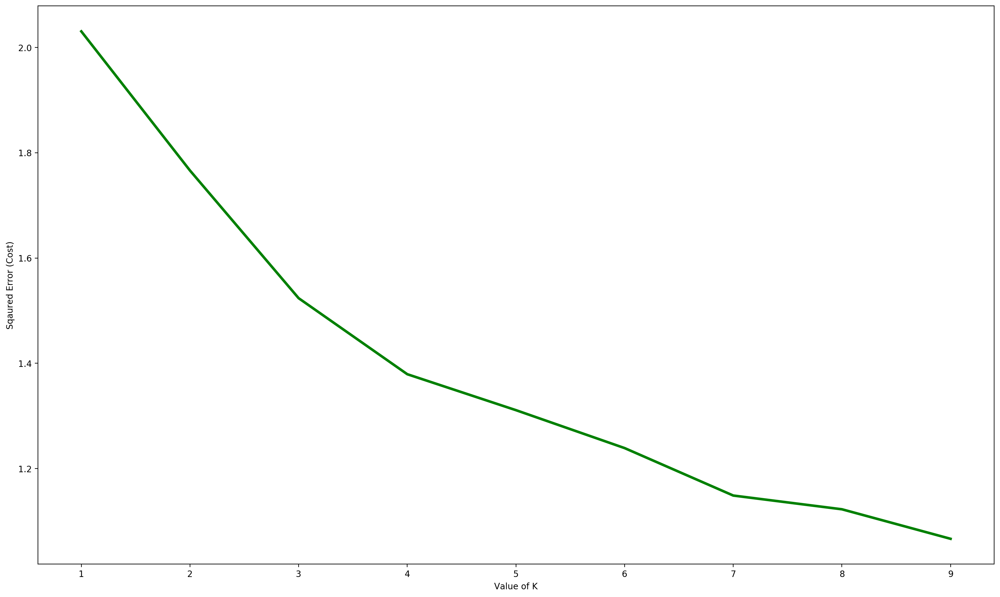

In [58]:
cost =[] 
for i in range(1, 10): 
    KM = KMeans(n_clusters=i, max_iter = 500).fit(Germany_clustering)
    
      
    # calculates squared error 
    # for the clustered points 
    cost.append(KM.inertia_)      
  
# plot the cost against K values 
plt.plot(range(1, 10), cost, color ='g', linewidth ='3') 
plt.xlabel("Value of K") 
plt.ylabel("Sqaured Error (Cost)") 
plt.show() # clear the plot 
  
# the point of the elbow is the  
# most optimal value for choosing k 

Let's create a new dataframe that includes the cluster as well as the top 15 venues for each city.

In [59]:
# Here we add the clustering labels
City_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

Germany_merged = df1

# Lets merge City_venues_sorted with df1 to add latitude/longitude for each City
Germany_merged = Germany_merged.join(City_venues_sorted.set_index('City'), on='City')

Germany_merged.head() # check the last columns!

,City,Population 2018,Population/km²,Area(km²),City_Lat,City_Long,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue
0,Berlin,3644826,4088,891,52.517037,13.388860,6,Hotel,History Museum,Theater,German Restaurant,Art Gallery,Gourmet Shop,Chocolate Shop,Concert Hall,Monument / Landmark,Plaza,Optical Shop,Bar,Clothing Store,Drugstore,Bookstore
1,Hamburg,1841179,2438,755,53.550341,10.000654,6,Hotel,Coffee Shop,Café,Art Gallery,German Restaurant,Steakhouse,Vietnamese Restaurant,Theater,Clothing Store,Italian Restaurant,Furniture / Home Store,Drugstore,Art Museum,French Restaurant,Asian Restaurant
2,München,1471508,4736,310,48.137108,11.575382,1,Café,Hotel,Bavarian Restaurant,German Restaurant,Plaza,Cocktail Bar,Restaurant,Boutique,Church,Department Store,Bookstore,Steakhouse,Coffee Shop,Opera House,Wine Bar
3,Köln,1085664,2681,404,50.938361,6.959974,6,Hotel,Brewery,Italian Restaurant,Art Museum,German Restaurant,Pedestrian Plaza,Coffee Shop,Gym / Fitness Center,Café,Plaza,Gift Shop,Bakery,Scenic Lookout,Gourmet Shop,Department Store
4,Frankfurt am Main,753056,3033,248,50.110644,8.682092,1,Café,Bar,Boutique,Restaurant,Plaza,German Restaurant,Art Museum,Coffee Shop,Italian Restaurant,Lounge,Scenic Lookout,Bistro,Market,Dessert Shop,Ice Cream Shop


### Time to see the map of clustered Cities :

In [60]:
# create map
map_clusters = folium.Map(location=[52.517037, 13.388860], zoom_start=6)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(Germany_merged['City_Lat'], Germany_merged['City_Long'], Germany_merged['City'], Germany_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

The map above can be interpreted as : the same colored cities are the most "closer" cities to each other in manner of Venues in them..<br> Of course It is with some assumptions..But methedology can be easly adapted to new data sets.For example if max. Nr of venues for each <br> City increases from 100 to 1000, still same code will analyse and cluster the cities accordinly..

If we want to see the visual results in the text form , below tells us which city falls which group...

In [61]:
pd.set_option('display.max_colwidth', 150)

In [62]:
Germany_merged.groupby('Cluster Labels')['City'].apply(', '.join)

Cluster Labels
0                                                                                                                                                Osnabrück
1    München, Frankfurt am Main, Bremen, Nürnberg, Duisburg, Bonn, Münster, Karlsruhe, Mannheim, Braunschweig, Kiel, Halle (Saale), Freiburg im Breisga...
2                                                                                                                                               Salzgitter
3    Gelsenkirchen, Krefeld, Kassel, Hagen, Solingen, Herne, Pforzheim, Bottrop, Reutlingen, Bremerhaven, Recklinghausen, Bergisch Gladbach, Remscheid,...
4                                                                                                                                                Wuppertal
5                                                                                                                                                     Hamm
6    Berlin, Hamburg, Köln, Stuttgart, Düsseldorf, Leip

### Even some better presentation , with heatmap direclty in Pandas data frame : 

In [63]:
Germany_grouped2= Germany_grouped.set_index('City').transpose()

In [64]:
Germany_grouped2.style.background_gradient(cmap="Greens", low = 0, high = 0.3)

Some additional Visualisations :

#### Seaborn Heatmap :

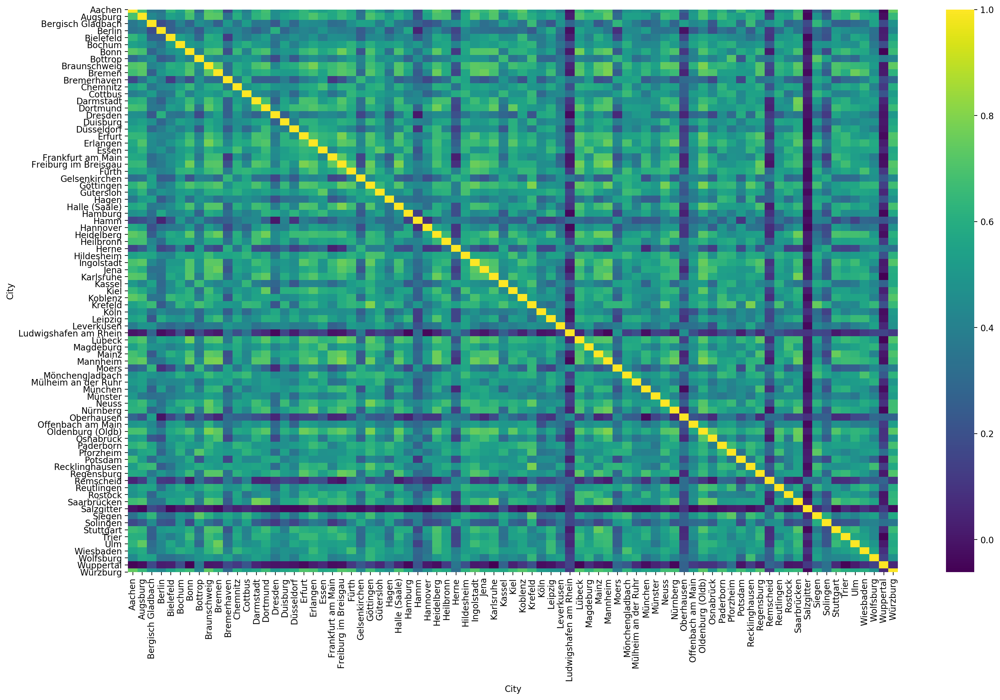

In [65]:
DE_Corr = Germany_grouped2.corr()
# plot the heatmap and annotation on it
sns.heatmap(DE_Corr, xticklabels=DE_Corr.columns, yticklabels=DE_Corr.columns, cmap='viridis', annot=False)

#### Seaborn Clustermap with Heatmap :

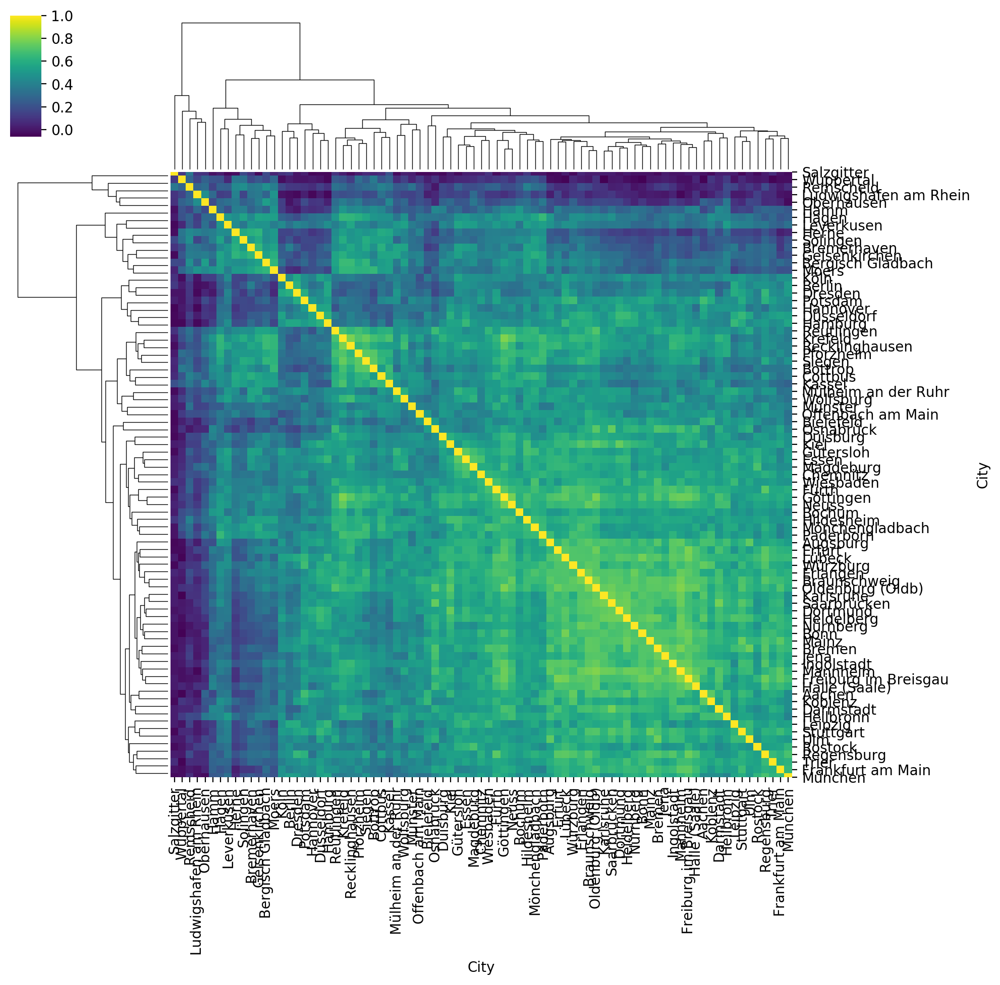

In [66]:
DE_Corr = Germany_grouped2.corr()
# plot the heatmap and annotation on it
sns.clustermap(DE_Corr, xticklabels=DE_Corr.columns, yticklabels=DE_Corr.columns, cmap='viridis', annot=False)

### --------Takes too long to print ---

In [ ]:
# plot the cluster heatmap and annotation on it

# sns.clustermap(Germany_grouped2, cmap='Blues', annot=True, figsize=(90,60))

### ------- Finish --------

### ----A nice Plot to understand Single Cities ----

Lets create a heatmap with a targetted business..You can just change 'Target_Business' variable to get desired Venue's distibution on Cities <br>
For example : If the Target_Business ='Café' we see that City 'Hamm' is the most competetive City with 0.20 percent venue occurance in 1250 meters from the City center...

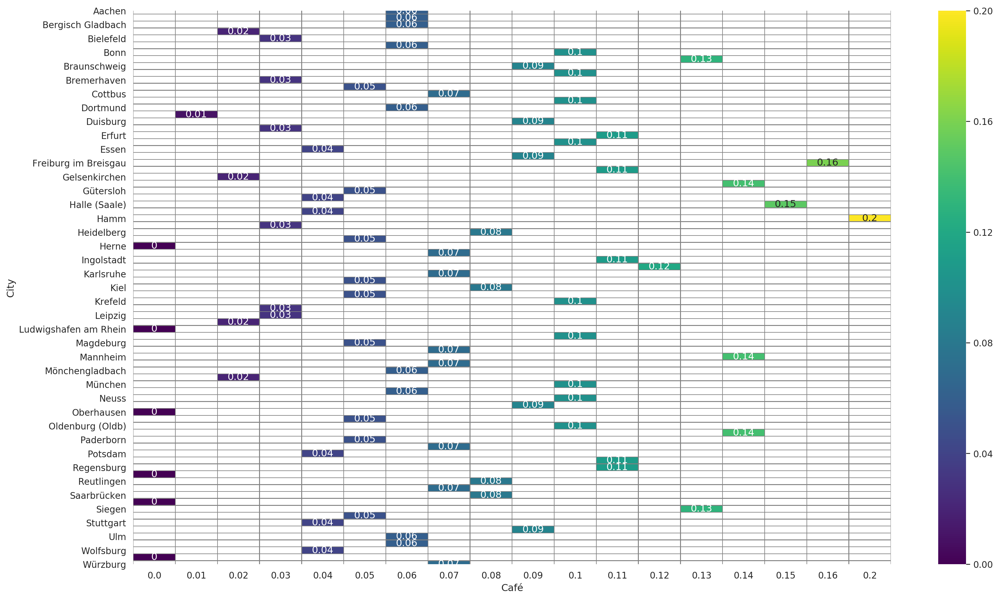

In [67]:
Target_Business ='Café'

sns.set(context='paper', style='white', palette='deep', font='sans-serif', font_scale=1.2, color_codes=True, rc=None)
result = Germany_grouped.pivot(index='City', columns=Target_Business, values=Target_Business)
sns.heatmap(result, annot=True, cmap='viridis', linewidths =0.5, linecolor='grey', cbar=True, fmt="g")

#### --Some experimental Visualisation ---

In [68]:
from scipy.cluster import hierarchy

{'icoord': [[35.0, 35.0, 45.0, 45.0],
  [25.0, 25.0, 40.0, 40.0],
  [15.0, 15.0, 32.5, 32.5],
  [55.0, 55.0, 65.0, 65.0],
  [23.75, 23.75, 60.0, 60.0],
  [75.0, 75.0, 85.0, 85.0],
  [95.0, 95.0, 105.0, 105.0],
  [125.0, 125.0, 135.0, 135.0],
  [115.0, 115.0, 130.0, 130.0],
  [100.0, 100.0, 122.5, 122.5],
  [80.0, 80.0, 111.25, 111.25],
  [175.0, 175.0, 185.0, 185.0],
  [165.0, 165.0, 180.0, 180.0],
  [195.0, 195.0, 205.0, 205.0],
  [215.0, 215.0, 225.0, 225.0],
  [200.0, 200.0, 220.0, 220.0],
  [265.0, 265.0, 275.0, 275.0],
  [255.0, 255.0, 270.0, 270.0],
  [245.0, 245.0, 262.5, 262.5],
  [235.0, 235.0, 253.75, 253.75],
  [210.0, 210.0, 244.375, 244.375],
  [172.5, 172.5, 227.1875, 227.1875],
  [155.0, 155.0, 199.84375, 199.84375],
  [305.0, 305.0, 315.0, 315.0],
  [335.0, 335.0, 345.0, 345.0],
  [325.0, 325.0, 340.0, 340.0],
  [310.0, 310.0, 332.5, 332.5],
  [295.0, 295.0, 321.25, 321.25],
  [285.0, 285.0, 308.125, 308.125],
  [177.421875, 177.421875, 296.5625, 296.5625],
  [145.0, 14

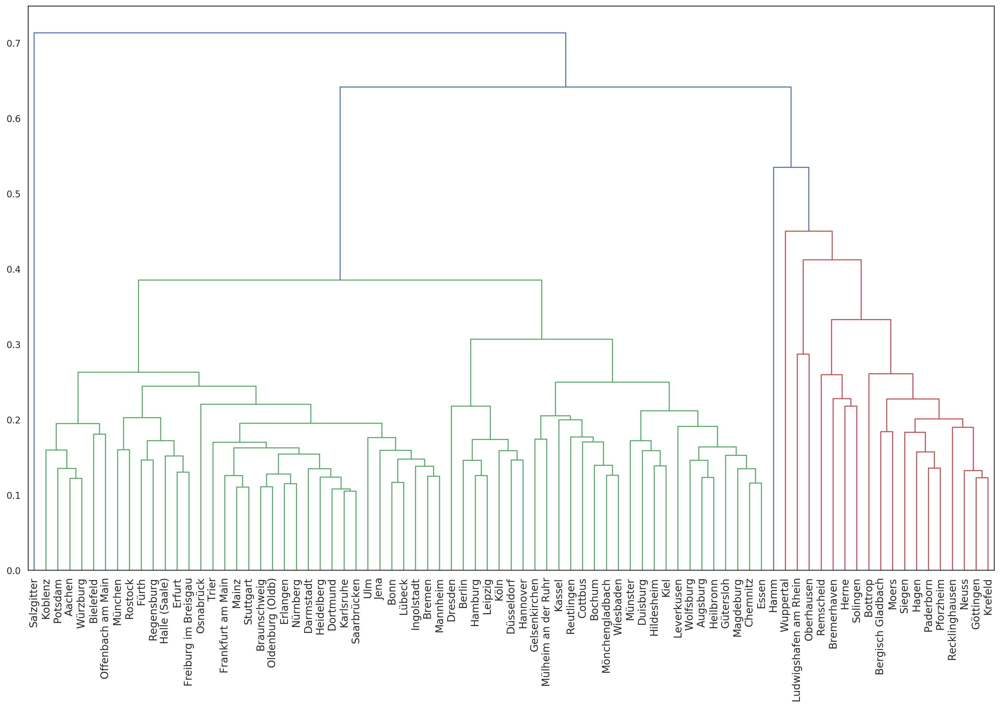

In [69]:

df8 = Germany_grouped
df8 = df8.set_index('City')
del df8.index.name

 
# Calculate the distance between each sample
Z = hierarchy.linkage(df8, 'ward')
 
 
# Plot with Custom leaves
hierarchy.dendrogram(Z, leaf_rotation=90, leaf_font_size=12, labels=df8.index)


### ---Folium Choropleth map ---

In [70]:
district_geo = r'DE_cities.geojson'

In [71]:
district_geo

'DE_cities.geojson'

In [72]:
# Initialize the map:



m = folium.Map(location=[52.517037, 13.388860], zoom_start=6)


 
# Add the color for the chloropleth:
m.choropleth(
 geo_data=district_geo,
 name='choropleth',
 data=dfinal,
 columns=['City', 'Population 2018'],
 key_on = 'feature.properties.NAME_3',
  fill_color='RdPu', 
 fill_opacity=0.7,
 line_opacity=0.2,
 highlight ='True',
 line_color='blue',
 line_weight=3, 
 legend_name='Population 2018'
)
folium.LayerControl().add_to(m)
 
# Save to html
m.save('#Folium_chloropleth_DE5.html')

m

In [ ]:
# Initialize the map:



m = folium.Map(location=[52.517037, 13.388860], zoom_start=6)


 
# Add the color for the HeatMap:
m.HeatMap(
 geo_data=district_geo,
 name='choropleth',
 data=dfinal,
 columns=['City', 'Population 2018'],
 key_on = 'feature.properties.NAME_3',
  fill_color='RdPu', 
 fill_opacity=0.7,
 line_opacity=0.2,
 highlight ='True',
 line_color='blue',
 line_weight=3, 
 legend_name='Population 2018'
)
folium.LayerControl().add_to(m)
 
# Save to html
m.save('#Folium_chloropleth_DE6.html')

# m

In [ ]:
from folium.plugins import HeatMap

m = folium.Map(location=[52.517037, 13.388860], zoom_start=6)


data = list(zip(dfinal.City_Lat.values, dfinal.City_Long.values, dfinal['Population 2018'].values))


HeatMap(data, min_opacity=0.5, max_val=3000000, radius=17, blur=5, popup='city', max_zoom=10).add_to(m)

m.save('#Folium_chloropleth_DE8.html')

### -------- Geopandas  Map ----------

In [78]:
Germany_geo = geopandas.read_file('DE_cities.geojson')

In [79]:
Germany_geo.sample(5)

,ID_0,ISO,NAME_0,ID_1,NAME_1,ID_2,NAME_2,ID_3,NAME_3,NL_NAME_3,VARNAME_3,TYPE_3,ENGTYPE_3,geometry
187,86,DEU,Germany,7,Hessen,16,Darmstadt,171,Offenbach am Main Städte,None,None,Kreisfreie Städte,Urban district,"POLYGON ((8.83444 50.13390, 8.83487 50.12284, 8.82322 50.12260, 8.82337 50.11891, 8.82933 50.11535, 8.82961 50.10798, 8.83556 50.10442, 8.84167 50..."
416,86,DEU,Germany,16,Thüringen,40,Thüringen,417,Gotha,None,None,Landkreise,Rural district,"POLYGON ((10.61533 51.03504, 10.62702 51.03510, 10.62707 51.02768, 10.64458 51.03149, 10.64455 51.03520, 10.65622 51.03898, 10.66207 51.03902, 10...."
296,86,DEU,Germany,10,Nordrhein-Westfalen,28,Munster,297,Borken,None,None,Landkreise,Rural district,"POLYGON ((7.10657 52.24444, 7.10081 52.24055, 7.10245 52.22181, 7.09783 52.20663, 7.10457 52.19928, 7.10493 52.19553, 7.11131 52.19193, 7.11733 52..."
86,86,DEU,Germany,2,Bayern,7,Oberbayern,70,Bad Tölz-Wolfratshausen,None,None,Landkreise,Rural district,"POLYGON ((11.62706 47.91492, 11.63259 47.91489, 11.63253 47.90746, 11.64357 47.90368, 11.64360 47.90739, 11.65463 47.90361, 11.66010 47.89614, 11...."
236,86,DEU,Germany,9,Niedersachsen,21,Hannover,220,Hildesheim,None,None,Landkreise,Rural district,"POLYGON ((10.25853 52.18811, 10.25864 52.17692, 10.25262 52.17683, 10.25258 52.18056, 10.24657 52.18047, 10.23458 52.17656, 10.23454 52.18029, 10...."


In [80]:
germany_shape = geopandas.read_file('de_10km.shp')

In [81]:
Germany_geo = Germany_geo[['NAME_3','geometry']]
Germany_geo.rename(columns={'NAME_3':'City'}, inplace=True)

In [82]:
Germany_geo["City"]=Germany_geo["City"].str.replace(' Städte','')

In [83]:
dfinal_with_geo=Germany_geo.merge(dfinal, on="City")

In [84]:
dfinal_with_geo.head(10)

,City,geometry,Population 2018,Population/km²,Area(km²),City_Lat,City_Long,Income /Pers. €,Average Unemployment rate
0,Osnabrück,"POLYGON ((7.96379 52.32545, 7.96960 52.32937, 7.98748 52.33369, 8.01185 52.34164, 8.01892 52.32340, 8.02531 52.31985, 8.05621 52.32048, 8.06262 52...",164748,1375,119,52.266837,8.049741,21184.0,5.05
1,Osnabrück,"POLYGON ((8.02655 52.68435, 8.03910 52.67371, 8.06461 52.64500, 8.07669 52.64536, 8.08308 52.63818, 8.08361 52.62713, 8.08965 52.62730, 8.09001 52...",164748,1375,119,52.266837,8.049741,21184.0,5.05
2,Bochum,"POLYGON ((7.30011 51.52621, 7.31223 51.51926, 7.31808 51.51948, 7.31830 51.51578, 7.31266 51.51186, 7.30681 51.51163, 7.30744 51.50053, 7.31915 51...",364628,2503,145,51.481811,7.219664,19620.0,8.80
3,Dortmund,"POLYGON ((7.42522 51.59772, 7.42547 51.59401, 7.43164 51.59050, 7.43189 51.58679, 7.42622 51.58288, 7.42031 51.58267, 7.43238 51.57937, 7.45039 51...",587010,2091,280,51.514227,7.465279,18946.0,10.20
4,Hagen,"POLYGON ((7.51410 51.41530, 7.50837 51.41141, 7.51433 51.41161, 7.52050 51.40811, 7.52072 51.40442, 7.53264 51.40482, 7.53882 51.40133, 7.53286 51...",188814,1177,160,51.358294,7.473296,19774.0,9.30
5,Hamm,"POLYGON ((7.74337 51.73472, 7.75529 51.73509, 7.75555 51.73138, 7.76177 51.72786, 7.76773 51.72804, 7.76799 51.72433, 7.77421 51.72081, 7.77395 51...",179111,791,226,51.661627,7.821683,18006.0,8.75
6,Herne,"POLYGON ((7.15507 51.54556, 7.16070 51.54587, 7.17224 51.54275, 7.18898 51.54733, 7.19467 51.54762, 7.20582 51.55189, 7.21703 51.55614, 7.21727 51...",156374,3041,51,51.538039,7.219985,17579.0,10.85
7,Stuttgart,"POLYGON ((9.31032 48.77663, 9.29910 48.77277, 9.29920 48.76908, 9.27657 48.76875, 9.27687 48.75764, 9.27121 48.75756, 9.26029 48.74258, 9.24333 48...",634830,3062,207,48.778449,9.180013,25012.0,4.20
8,Reutlingen,"POLYGON ((9.15107 48.60380, 9.15661 48.60760, 9.16235 48.60398, 9.17364 48.60416, 9.17354 48.60786, 9.18494 48.60434, 9.17929 48.60425, 9.18504 48...",115966,1332,87,48.491951,9.211414,23954.0,3.15
9,Ulm,"POLYGON ((10.00016 48.35505, 9.99456 48.35495, 9.98342 48.35102, 9.98902 48.35113, 9.98907 48.34742, 9.97794 48.34350, 9.97800 48.33979, 9.98920 4...",126329,1064,118,48.397400,9.993434,29641.0,3.30


In [85]:
Germany_geo.head()

,City,geometry
0,Oldenburg,"POLYGON ((8.65348 53.11003, 8.66599 53.10659, 8.67216 53.10675, 8.66639 53.09915, 8.66659 53.09543, 8.67314 53.08812, 8.69163 53.08853, 8.69799 53..."
1,Osnabrück,"POLYGON ((7.96379 52.32545, 7.96960 52.32937, 7.98748 52.33369, 8.01185 52.34164, 8.01892 52.32340, 8.02531 52.31985, 8.05621 52.32048, 8.06262 52..."
2,Osnabrück,"POLYGON ((8.02655 52.68435, 8.03910 52.67371, 8.06461 52.64500, 8.07669 52.64536, 8.08308 52.63818, 8.08361 52.62713, 8.08965 52.62730, 8.09001 52..."
3,Vechta,"POLYGON ((8.46214 52.80015, 8.45627 52.79629, 8.45646 52.79258, 8.45059 52.78872, 8.45706 52.78146, 8.45726 52.77774, 8.46334 52.77788, 8.46394 52..."
4,Wesermarsch,"MULTIPOLYGON (((8.30750 53.61819, 8.30750 53.61792, 8.30861 53.61792, 8.30861 53.61764, 8.31139 53.61764, 8.31139 53.61792, 8.31194 53.61792, 8.31..."


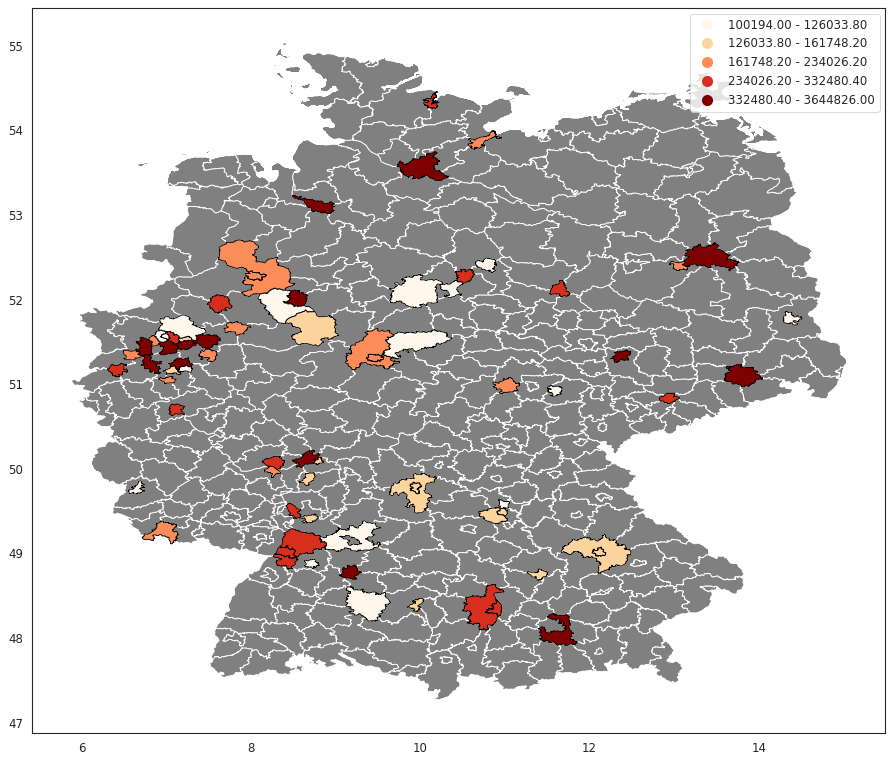

In [86]:

%matplotlib inline
plt.rcParams['figure.figsize'] = [16, 12]
plt.rcParams['figure.dpi'] = 80


ax = Germany_geo.plot(color="grey")

dfinal_with_geo.dropna().plot(ax=ax, column='Population 2018', cmap='OrRd',scheme='quantiles', edgecolor='black', figsize=(16, 10), legend=True)


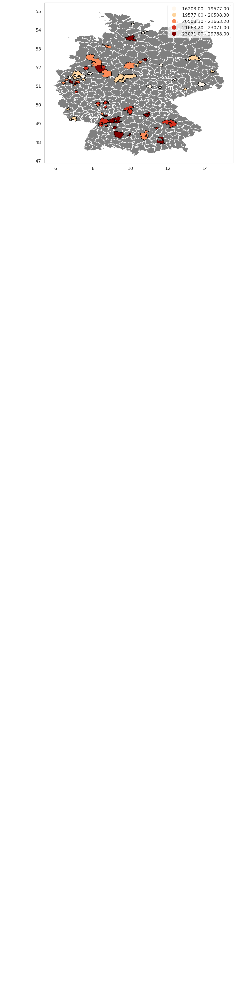

In [87]:

%matplotlib inline
plt.rcParams['figure.figsize'] = [8, 16]
plt.rcParams['figure.dpi'] = 150


ax = Germany_geo.plot(color="grey")

ax.annotate('local max', xy=(3, 1),  xycoords='data',
            xytext=(0.8, 0.95), textcoords='axes fraction',
            arrowprops=dict(facecolor='black', shrink=0.05),
            horizontalalignment='right', verticalalignment='top',
            )

dfinal_with_geo.dropna().plot(ax=ax, column='Income /Pers. €', cmap='OrRd',scheme='quantiles', edgecolor='black', figsize=(8, 16), legend=True)

## Final Words Conclusions comes here , Not Finished yet...


### Thank you for your reading! 
Uygar Hizal